# Task 1: Filters Visualization
## 1.1 - Load VGG16
We are loading a (pretrained) VGG16 via torchvision

In [1]:
import numpy as np
import os
import torch
from PIL import Image
from torch.optim import Adam
from torchvision import models
from torch.optim import Adam
from filters_visualization import visualise_layer_filter
from filters_visualization_custom import visualise_layer_filter_custom
from filters_visualization_task2 import visualise_layer_filter_task2, visualise_layer_filter_task2_multLayers
from aux_ops import preprocess_image, recreate_image
import matplotlib.pyplot as plt

# Decrease plot quality, because .ipynb gets too large in size
plt.rcParams['figure.dpi'] = 50  # default for jupyter is 72


In [2]:
# Select the device to work on.
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# model = TODO
model = models.vgg16()
model.load_state_dict(torch.load('vgg16-397923af.pth'))
model

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

## 1.2 - Optimize input image


In [3]:
# TODO: add your code here

use_gpu = False
if torch.cuda.is_available():
    use_gpu = True
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Enable GPU
if use_gpu:
    model.cuda()

# Create input tensor X for forward pass
rand_img = np.uint8(np.random.uniform(low=120,
                                        high=190,
                                        size=(224, 224, 3)))
processed_image = preprocess_image(rand_img, False)
processed_image = torch.tensor(processed_image, device=device).float()
X = processed_image

# forward pass (without fully connected layers at the end) layer by layer 
model.eval()
print(f"Image shape: {X.shape}\n")
for index, layer in enumerate(model.features):
    print(f"Appying layer {index}: {layer}")
    X = layer(X)
    print(f"Activation shape: {X.shape}")
    print(f"Activation mean: {X.mean()}")
    print(f"Activation min: {X.min()}")
    print(f"Activation max: {X.max()}\n")

C:\Users\Benjo\AppData\Local\Temp\ipykernel_8448\4093148116.py:17: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  processed_image = torch.tensor(processed_image, device=device).float()


Image shape: torch.Size([1, 3, 224, 224])

Appying layer 0: Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
Activation shape: torch.Size([1, 64, 224, 224])
Activation mean: -0.07012540102005005
Activation min: -3.5369536876678467
Activation max: 4.83121395111084

Appying layer 1: ReLU(inplace=True)
Activation shape: torch.Size([1, 64, 224, 224])
Activation mean: 0.2662045657634735
Activation min: 0.0
Activation max: 4.83121395111084

Appying layer 2: Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
Activation shape: torch.Size([1, 64, 224, 224])
Activation mean: -0.26678332686424255
Activation min: -12.834884643554688
Activation max: 12.951547622680664

Appying layer 3: ReLU(inplace=True)
Activation shape: torch.Size([1, 64, 224, 224])
Activation mean: 0.5691746473312378
Activation min: 0.0
Activation max: 12.951547622680664

Appying layer 4: MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
Activation shape: torch.Size([1, 64,

## Task 1.3 - Visualize a random filter.

c:\Users\Benjo\projects\GenAI_SS24_Exercises\SS24_GenAI_ex5\filters_visualization.py:32: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  processed_image = torch.tensor(processed_image, device=device).float()


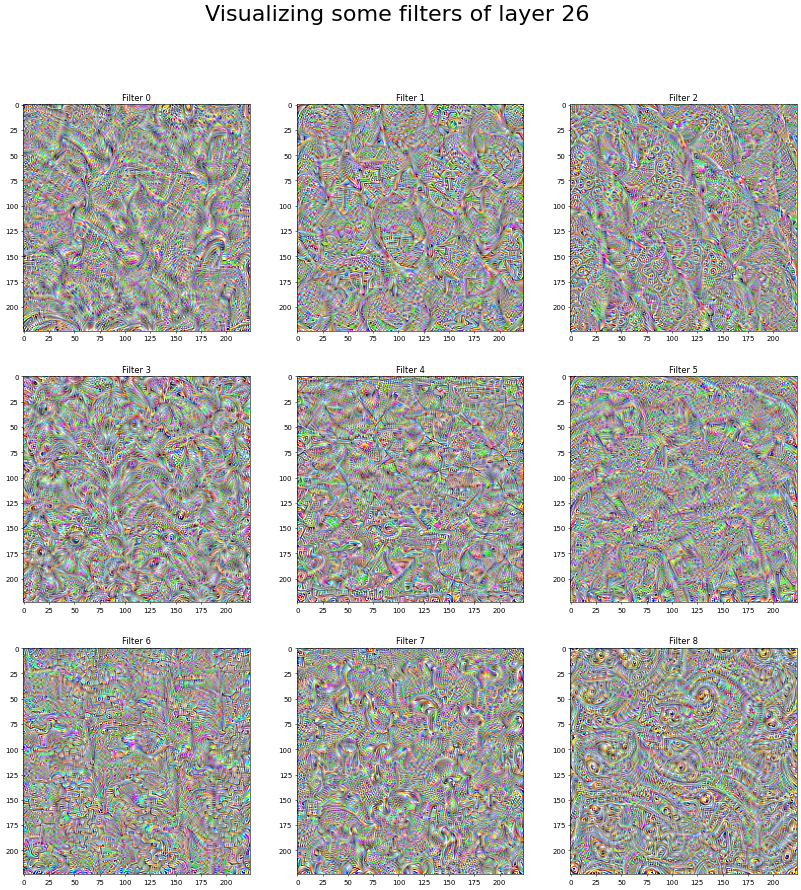

In [4]:
# TODO: add your code here

layerNr = 26
filterNrs = range(9) 

fig = plt.figure(figsize=(20, 20))
fig.suptitle(f'Visualizing some filters of layer {layerNr}', fontsize=32)

for i, filterNr in enumerate(filterNrs):
    img = visualise_layer_filter(model.features, layer_nmbr=layerNr, filter_nmbr=filterNr)
    
    ax = fig.add_subplot(3, 3, i+1) 
    ax.imshow(img)
    ax.title.set_text(f'Filter {filterNr}')

plt.show()

## Task 1.4 - Visualize filters at different layers.

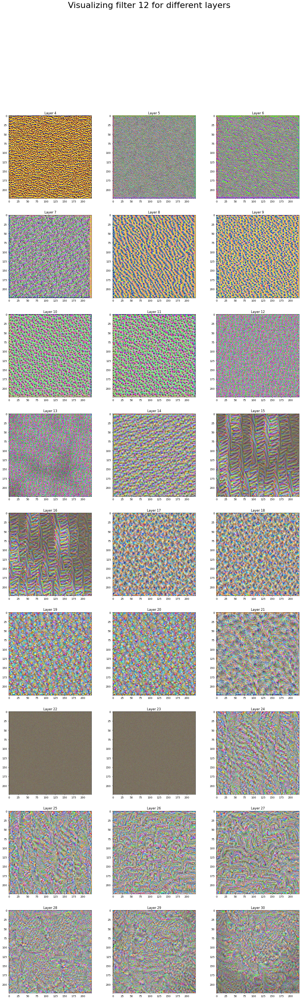

In [5]:
# TODO: add your code here

layerNrs = range(4,31)
filterNr = 12

fig = plt.figure(figsize=(20, 60))
fig.suptitle(f'Visualizing filter {filterNr} for different layers', fontsize=32)

for i, layerNr in enumerate(layerNrs):
    img = visualise_layer_filter(model.features, layer_nmbr=layerNr, filter_nmbr=filterNr)
    
    ax = fig.add_subplot(9, 3, i+1) 
    ax.imshow(img)
    ax.title.set_text(f'Layer {layerNr}')

plt.show()

By going from earlier layers to later layers, the optimized inputs first show larger and larger textures.
Thus earlier layers are more sensible to smaller and more simple textures on the input image while activations on later layers get more likely activated by the presence of larger and more complex textures.

## Task 1.5 - Hyperparameter tuning.


For this task, lets look at layer 29

c:\Users\Benjo\projects\GenAI_SS24_Exercises\SS24_GenAI_ex5\filters_visualization_custom.py:35: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  processed_image = torch.tensor(processed_image, device=device).float()


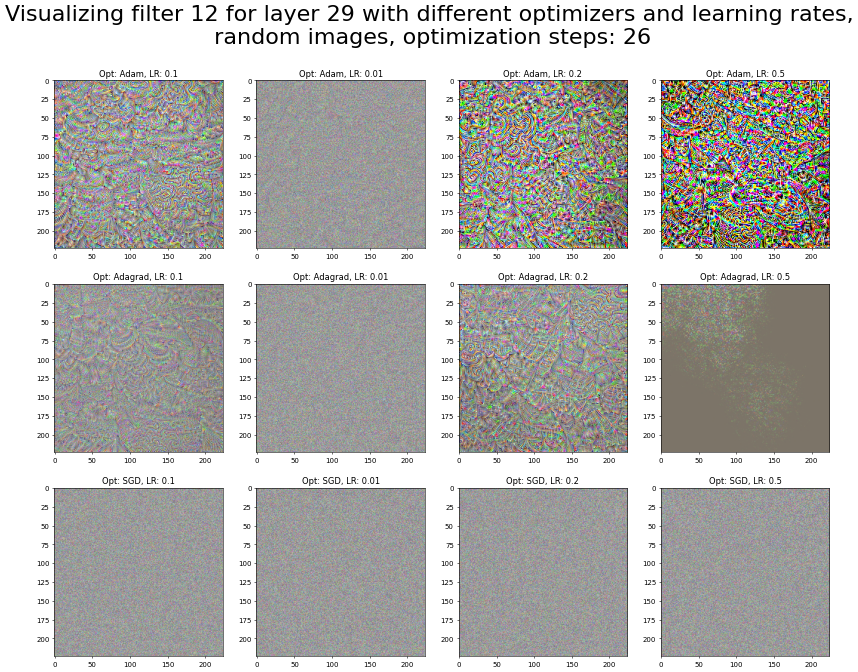

In [6]:
layerNr = 29
filterNr = 12

opts = ["Adam", "Adagrad", "SGD"]
lrs = [0.1, 0.01, 0.2, 0.5]

fig = plt.figure(figsize=(20, 15))
fig.suptitle(f'Visualizing filter {filterNr} for layer {layerNr} with different optimizers and learning rates,\n random images, optimization steps: 26', fontsize=32)

subplot_index = 1
for i, opt in enumerate(opts):
    for j, lr in enumerate(lrs):
        img = visualise_layer_filter_custom(model.features, 
                                            layer_nmbr=layerNr, 
                                            filter_nmbr=filterNr, 
                                            num_optim_steps=26, 
                                            rnd=True,
                                            opt=opt,
                                            lr=lr)
        
        ax = fig.add_subplot(len(opts), len(lrs), subplot_index) 
        ax.imshow(img)
        ax.title.set_text(f'Opt: {opt}, LR: {lr}')
        subplot_index += 1

plt.show()

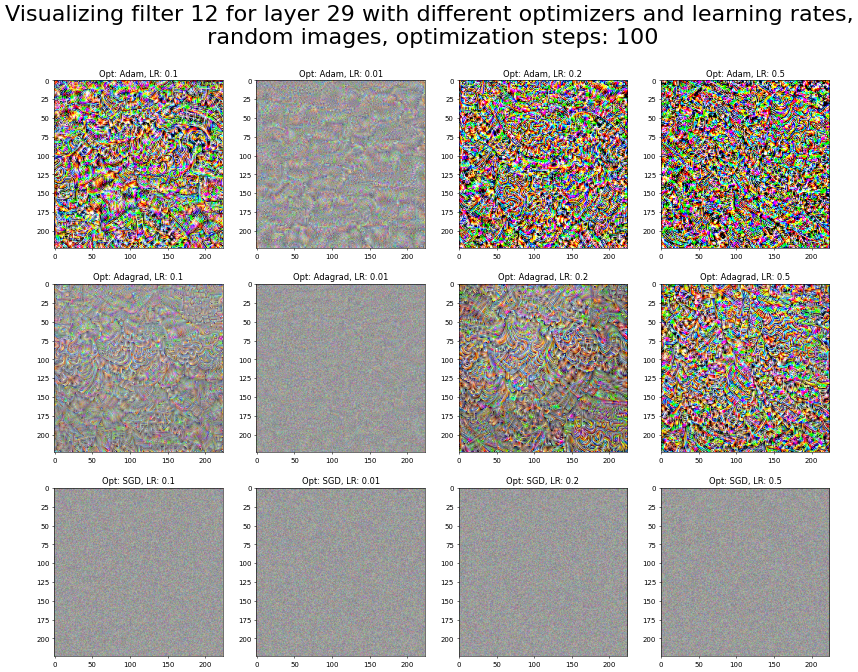

In [7]:
layerNr = 29
filterNr = 12

opts = ["Adam", "Adagrad", "SGD"]
lrs = [0.1, 0.01, 0.2, 0.5]
optSteps = 100

fig = plt.figure(figsize=(20, 15))
fig.suptitle(f'Visualizing filter {filterNr} for layer {layerNr} with different optimizers and learning rates,\n random images, optimization steps: {optSteps}', fontsize=32)

subplot_index = 1
for i, opt in enumerate(opts):
    for j, lr in enumerate(lrs):
        img = visualise_layer_filter_custom(model.features, 
                                            layer_nmbr=layerNr, 
                                            filter_nmbr=filterNr, 
                                            num_optim_steps=optSteps, 
                                            rnd=True,
                                            opt=opt,
                                            lr=lr)
        
        ax = fig.add_subplot(len(opts), len(lrs), subplot_index) 
        ax.imshow(img)
        ax.title.set_text(f'Opt: {opt}, LR: {lr}')
        subplot_index += 1

plt.show()

With increased number of optimization iterations, we also see some structures when using lower learning rates more clearly, as exptected.

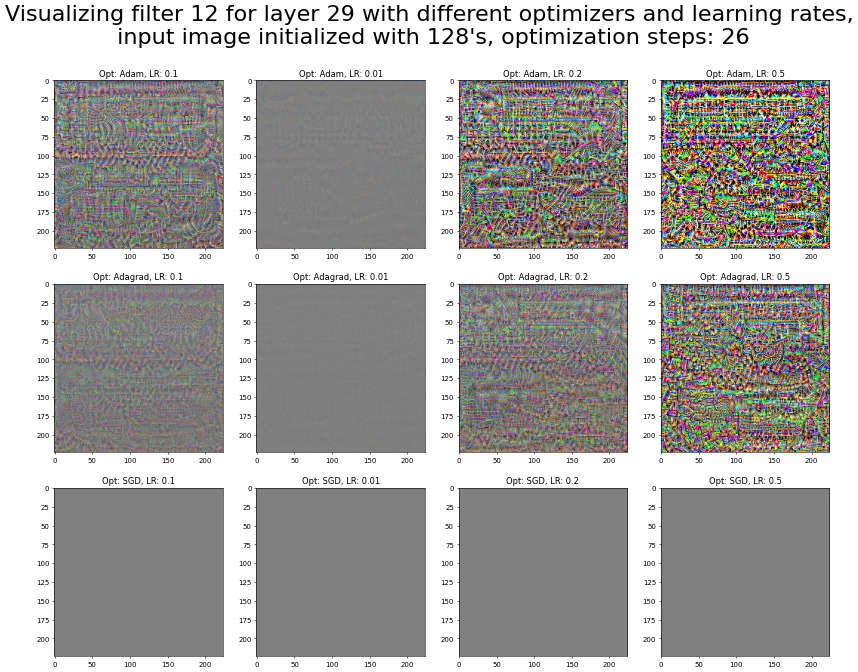

In [8]:
layerNr = 29
filterNr = 12

opts = ["Adam", "Adagrad", "SGD"]
lrs = [0.1, 0.01, 0.2, 0.5]
optSteps = 26

fig = plt.figure(figsize=(20, 15))
fig.suptitle(f"Visualizing filter {filterNr} for layer {layerNr} with different optimizers and learning rates,\n input image initialized with 128's, optimization steps: {optSteps}", fontsize=32)

subplot_index = 1
for i, opt in enumerate(opts):
    for j, lr in enumerate(lrs):
        img = visualise_layer_filter_custom(model.features, 
                                            layer_nmbr=layerNr, 
                                            filter_nmbr=filterNr, 
                                            num_optim_steps=optSteps, 
                                            rnd=False,
                                            opt=opt,
                                            lr=lr)
        
        ax = fig.add_subplot(len(opts), len(lrs), subplot_index) 
        ax.imshow(img)
        ax.title.set_text(f'Opt: {opt}, LR: {lr}')
        subplot_index += 1

plt.show()

Using the same initial value on every pixel in the inpugt image, previously emerged textures are now less present.

Overall in this setup Adam yields the best results, while with SGD it is hard to come up with something meaningful.

## Task 1.6 - Pretrained weights.


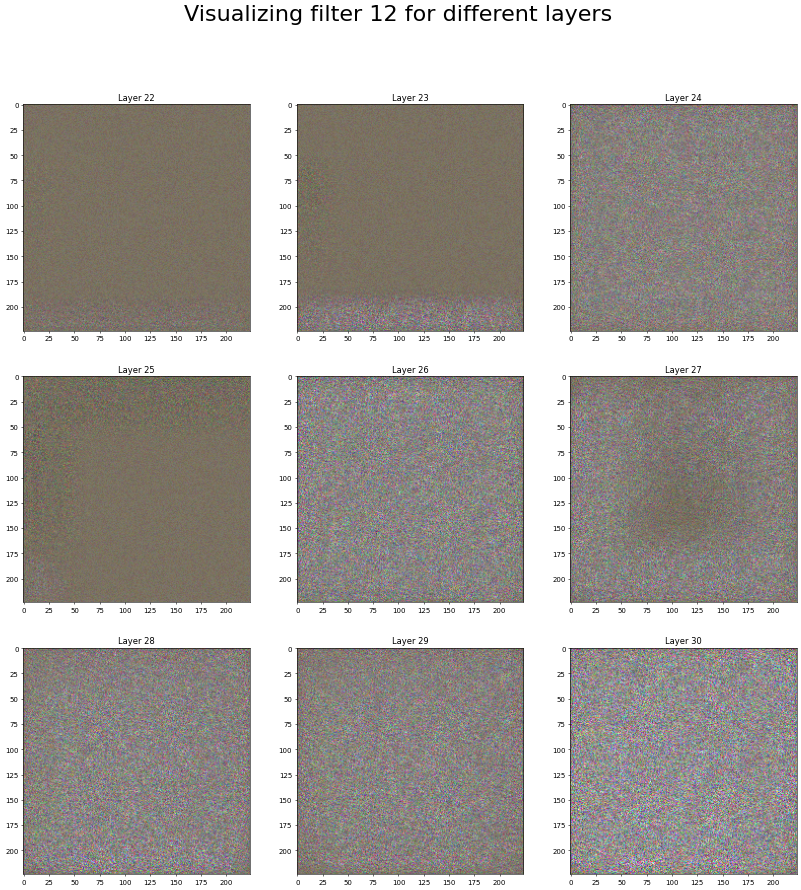

In [9]:
# TODO: add your code here

# Plot same visualization as in Task 1.4, but this time without pretrained weights
modelUntrained = models.vgg16()
modelUntrained.eval()

# Enable GPU
if use_gpu:
    modelUntrained.cuda()

layerNrs = range(22,31)
filterNr = 12

fig = plt.figure(figsize=(20, 20))
fig.suptitle(f'Visualizing filter {filterNr} for different layers', fontsize=32)

for i, layerNr in enumerate(layerNrs):
    img = visualise_layer_filter(modelUntrained.features, layer_nmbr=layerNr, filter_nmbr=filterNr)
    
    ax = fig.add_subplot(3, 3, i+1) 
    ax.imshow(img)
    ax.title.set_text(f'Layer {layerNr}')

plt.show()

As exptected, the are no textures emerging in this case (no trained weights -> we only see random noise from initialization of the weights)

# Task 2: Deep Dream

## Task 1.1 Most activated filters for every image

In [10]:
# TODO: add your code here
imagesNamesList = ["pexels_bird.jpg", "pexels_fruit.jpg", "pexels_kid.jpg", "pexels_man.jpg", "pexels_nature.jpg"]
imgs = [Image.open(imageName) for imageName in imagesNamesList]   


In [11]:
plt.rcParams['figure.dpi'] = 72  # default for jupyter is 72

Plot only for one image, because otherwise .ipynb file and PDF gets too big

could not transform PIL_img to a PIL Image object. Please check input.


c:\Users\Benjo\projects\GenAI_SS24_Exercises\SS24_GenAI_ex5\filters_visualization_task2.py:50: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  processed_image = torch.tensor(processed_image, device=device).float()


could not transform PIL_img to a PIL Image object. Please check input.
could not transform PIL_img to a PIL Image object. Please check input.
could not transform PIL_img to a PIL Image object. Please check input.
could not transform PIL_img to a PIL Image object. Please check input.
could not transform PIL_img to a PIL Image object. Please check input.
could not transform PIL_img to a PIL Image object. Please check input.
could not transform PIL_img to a PIL Image object. Please check input.
could not transform PIL_img to a PIL Image object. Please check input.
could not transform PIL_img to a PIL Image object. Please check input.


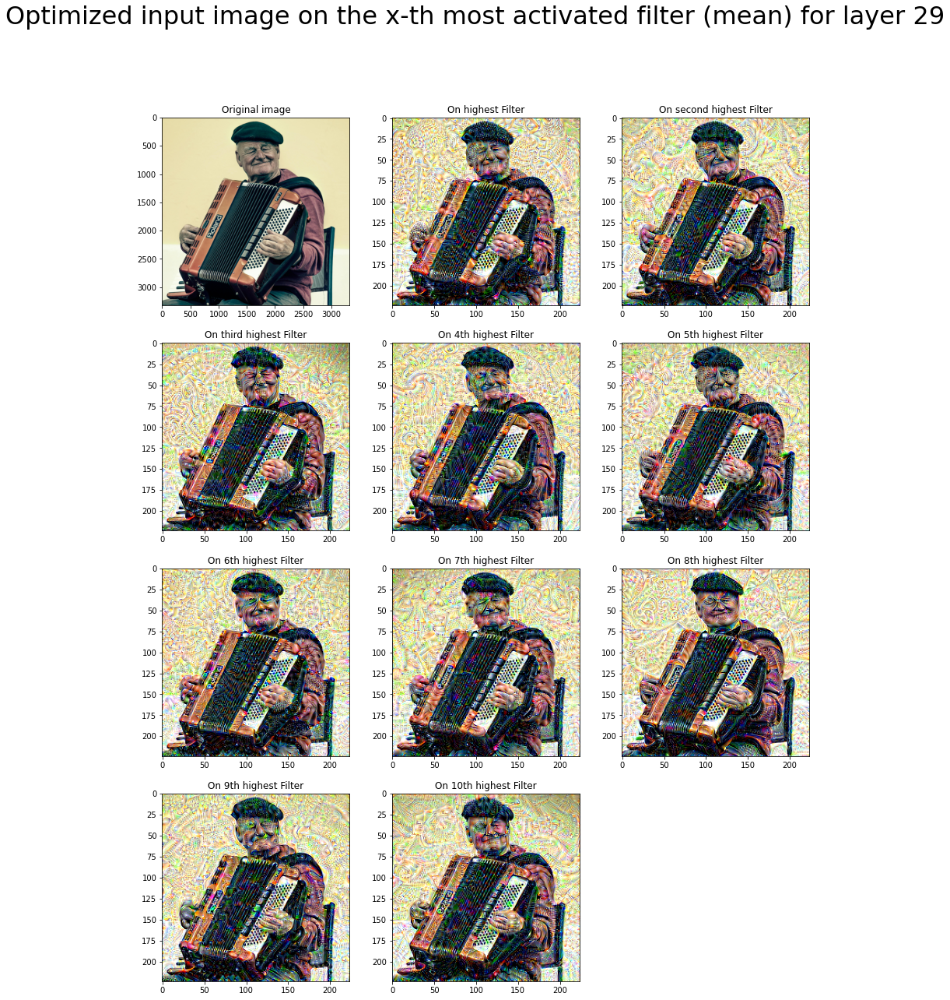

In [12]:
layerNr = 29
filterNr = None
highestFilters = range(1,11)
imgNr = 3

fig = plt.figure(figsize=(15, 20))
fig.suptitle(f'Optimized input image on the x-th most activated filter (mean) for layer {layerNr}', fontsize=32)

ax = fig.add_subplot(4, 3, 1) 
ax.imshow(imgs[imgNr])
ax.title.set_text("Original image")


for i, highestFilter in enumerate(highestFilters):
    optImg = visualise_layer_filter_task2(model.features,
                                    layer_nmbr=layerNr, 
                                    filter_nmbr=filterNr,
                                    inputMode="Image",
                                    img=imgs[imgNr],
                                    preProc=True,
                                    filterMode="Highest",
                                    highestFilter=highestFilter
                                    )
    
    ax = fig.add_subplot(4, 3, i+2) 
    ax.imshow(optImg)
    if highestFilter == 1:
        ax.title.set_text(f'On highest Filter')
    elif highestFilter == 2:
        ax.title.set_text(f'On second highest Filter')
    elif highestFilter == 3:
        ax.title.set_text(f'On third highest Filter')
    else:
        ax.title.set_text(f'On {highestFilter}th highest Filter')

plt.show()

Some deformations are sometimes already visible... e.g. on 9th highest filter the man's right hand. But still too noisy images

## Task 1.2 Total variation loss.

could not transform PIL_img to a PIL Image object. Please check input.
could not transform PIL_img to a PIL Image object. Please check input.
could not transform PIL_img to a PIL Image object. Please check input.
could not transform PIL_img to a PIL Image object. Please check input.
could not transform PIL_img to a PIL Image object. Please check input.
could not transform PIL_img to a PIL Image object. Please check input.
could not transform PIL_img to a PIL Image object. Please check input.
could not transform PIL_img to a PIL Image object. Please check input.
could not transform PIL_img to a PIL Image object. Please check input.
could not transform PIL_img to a PIL Image object. Please check input.


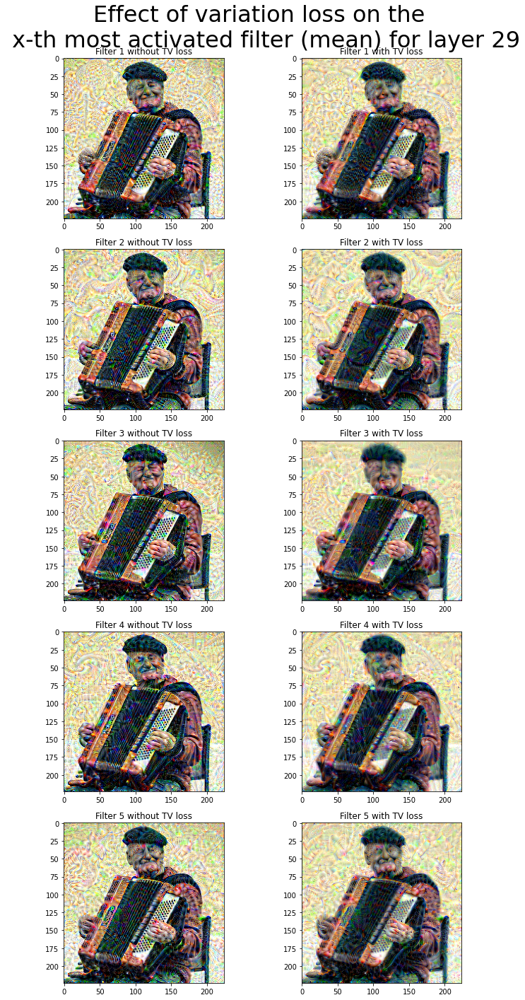

In [13]:
# TODO: add your code here
layerNr = 29
filterNr = None
highestFilters = range(1,6)
imgNr = 3

fig, axs = plt.subplots(5, 2, figsize=(10, 20))
fig.suptitle(f'Effect of variation loss on the \n x-th most activated filter (mean) for layer {layerNr}', fontsize=32)

for i, highestFilter in enumerate(highestFilters):
    # Without total variation loss
    optImg = visualise_layer_filter_task2(model.features,
                                    layer_nmbr=layerNr, 
                                    filter_nmbr=filterNr,
                                    inputMode="Image",
                                    img=imgs[imgNr],
                                    preProc=True,
                                    filterMode="Highest",
                                    highestFilter=highestFilter,
                                    addTvLoss=False,
                                    tvLossWeight=0.2
                                    )
    
    axs[i, 0].imshow(optImg)
    axs[i, 0].set_title(f'Filter {highestFilter} without TV loss')

    # With total variation loss
    optImg = visualise_layer_filter_task2(model.features,
                                    layer_nmbr=layerNr, 
                                    filter_nmbr=filterNr,
                                    inputMode="Image",
                                    img=imgs[imgNr],
                                    preProc=True,
                                    filterMode="Highest",
                                    highestFilter=highestFilter,
                                    addTvLoss=True,
                                    tvLossWeight=0.2
                                    )
    
    axs[i, 1].imshow(optImg)
    axs[i, 1].set_title(f'Filter {highestFilter} with TV loss')

plt.tight_layout()
plt.show()

## Task 1.3 Deep dream.

Optimizing on all filters of layer 29:

could not transform PIL_img to a PIL Image object. Please check input.


Text(0.5, 1.0, 'Optimized on all filters of layer 29')

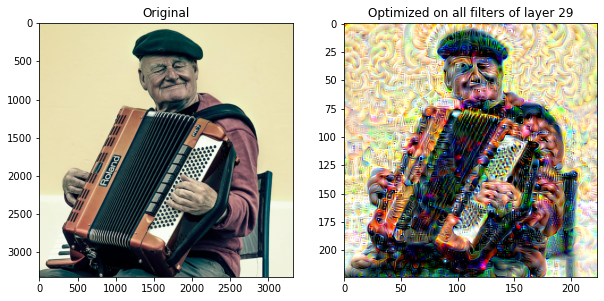

In [14]:
# TODO: add your code here
layerNr = 29
filterNr = None
imgNr = 3

fig, axs = plt.subplots(1, 2, figsize=(10, 20))
axs[0].imshow(imgs[imgNr])
axs[0].set_title("Original")
axs[1].imshow(visualise_layer_filter_task2(model.features,
                                    layer_nmbr=layerNr, 
                                    filter_nmbr=filterNr,
                                    inputMode="Image",
                                    img=imgs[imgNr],
                                    preProc=True,
                                    filterMode="All",
                                    addTvLoss=True,
                                    tvLossWeight=10,
                                    num_optim_steps=40
                                    ))
axs[1].set_title("Optimized on all filters of layer 29")

Now optimizing on all filters of multiple layers:

could not transform PIL_img to a PIL Image object. Please check input.


c:\Users\Benjo\projects\GenAI_SS24_Exercises\SS24_GenAI_ex5\filters_visualization_task2.py:152: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  processed_image = torch.tensor(processed_image, device=device).float()


could not transform PIL_img to a PIL Image object. Please check input.
could not transform PIL_img to a PIL Image object. Please check input.
could not transform PIL_img to a PIL Image object. Please check input.
could not transform PIL_img to a PIL Image object. Please check input.


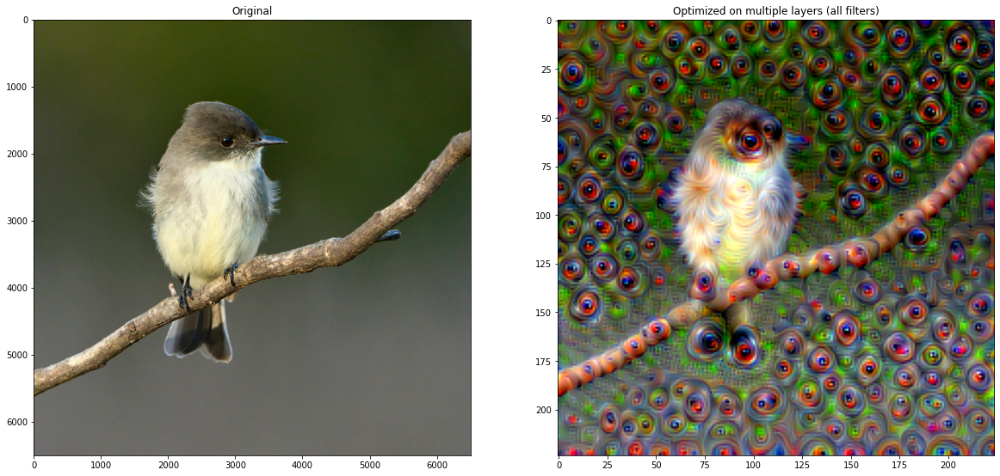

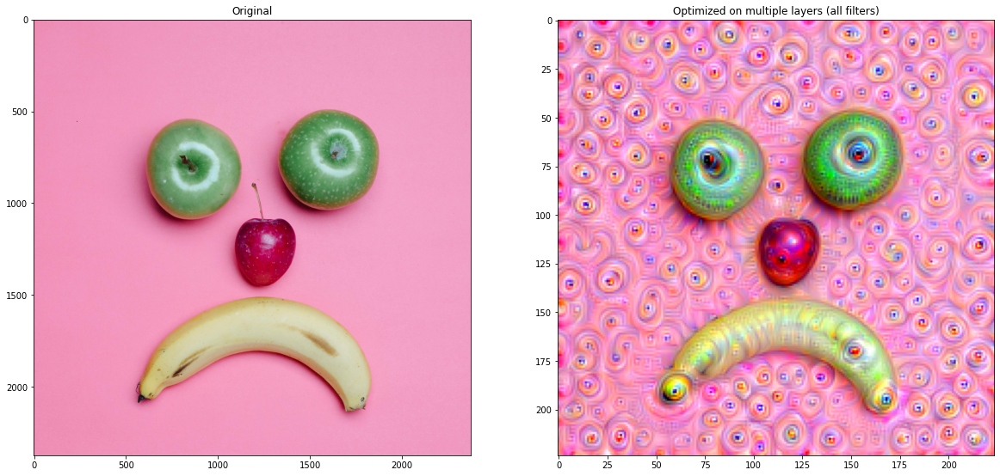

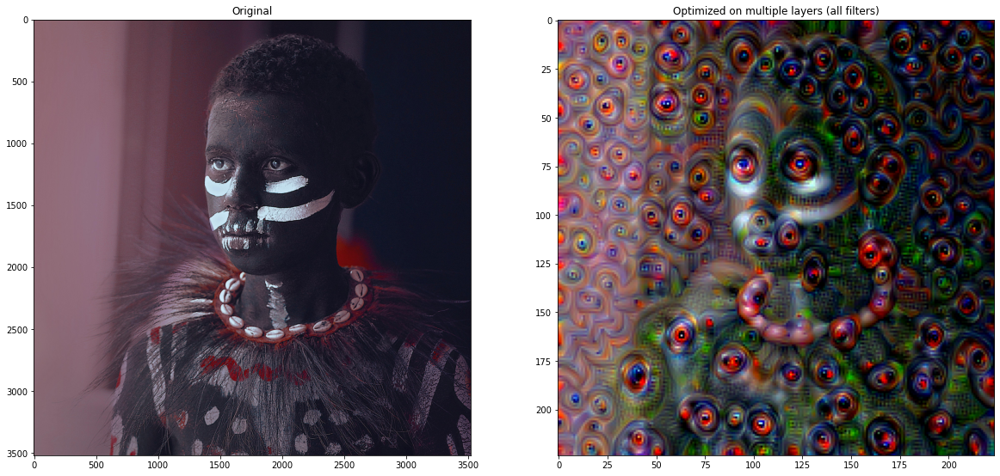

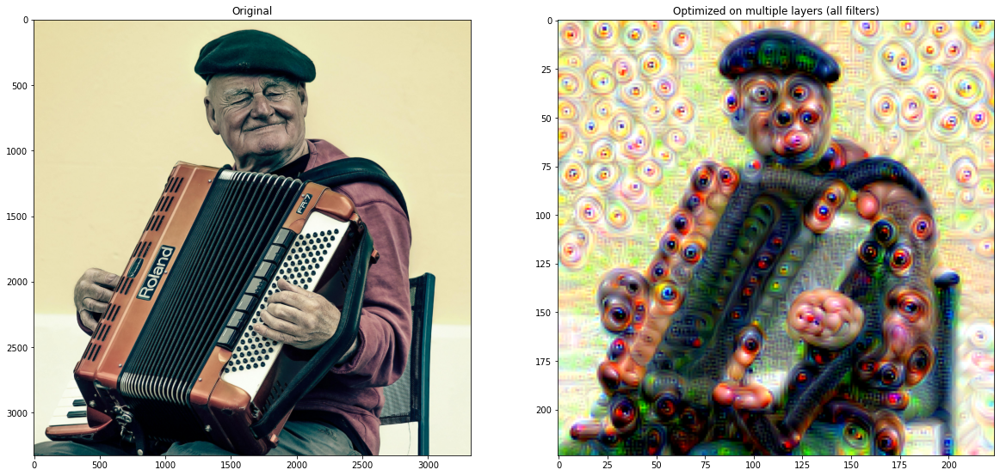

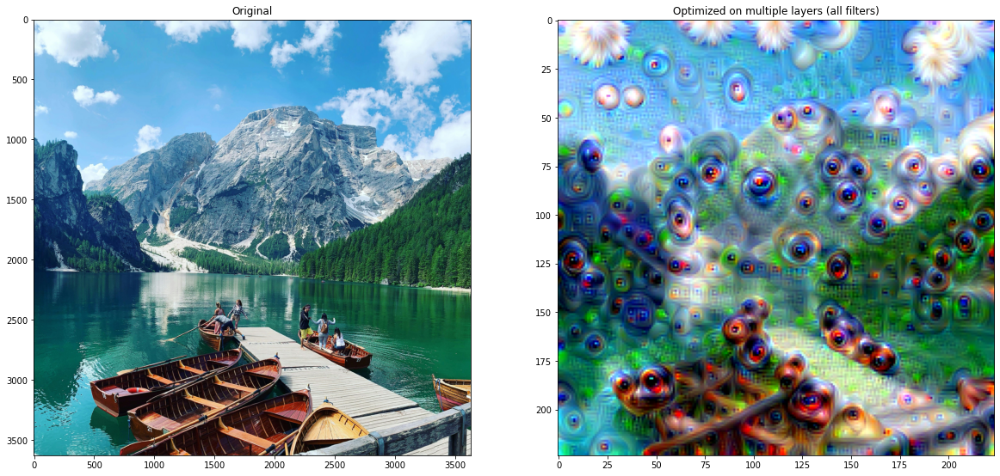

In [15]:
layerNrs = [16, 18, 20]

filterNr = None
num_optim_steps = 35
tvLossWeight = 100

for imgNr in range(5):

    fig, axs = plt.subplots(1, 2, figsize=(20, 30))
    axs[0].imshow(imgs[imgNr])
    axs[0].set_title("Original")
    axs[1].imshow(visualise_layer_filter_task2_multLayers(model.features,
                                        layer_nmbrs=layerNrs, 
                                        filter_nmbr=filterNr,
                                        inputMode="Image",
                                        img=imgs[imgNr],
                                        preProc=True,
                                        filterMode="All",
                                        addTvLoss=True,
                                        tvLossWeight=tvLossWeight,
                                        num_optim_steps=num_optim_steps
                                        ))
    axs[1].set_title("Optimized on multiple layers (all filters)")

It seems like these middle layers are very susceptible to eye-like textures

could not transform PIL_img to a PIL Image object. Please check input.
could not transform PIL_img to a PIL Image object. Please check input.
could not transform PIL_img to a PIL Image object. Please check input.
could not transform PIL_img to a PIL Image object. Please check input.
could not transform PIL_img to a PIL Image object. Please check input.


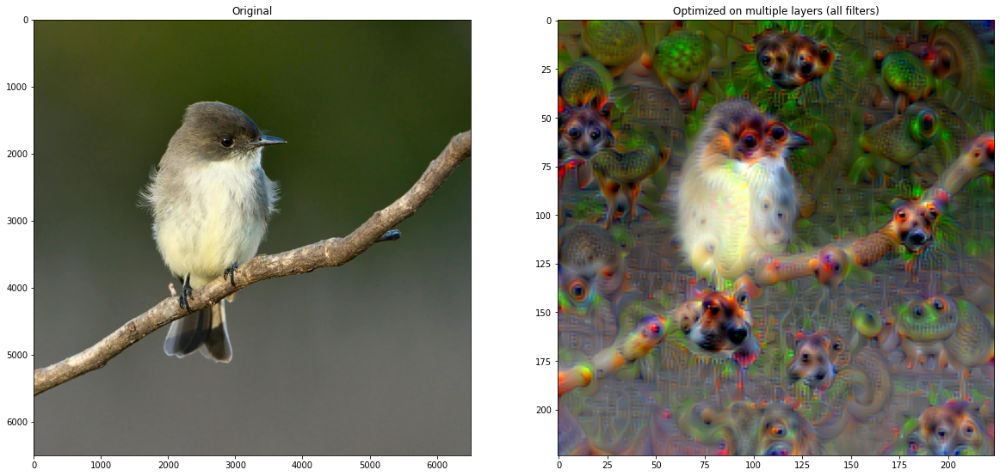

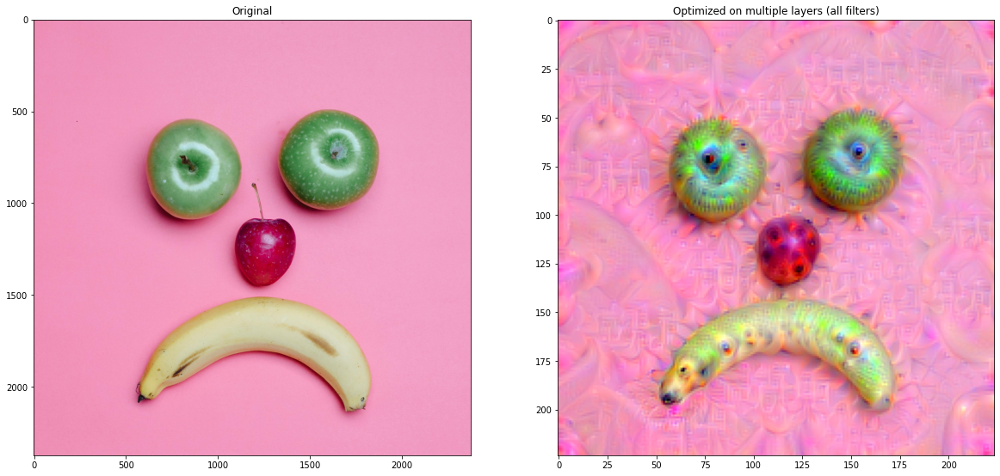

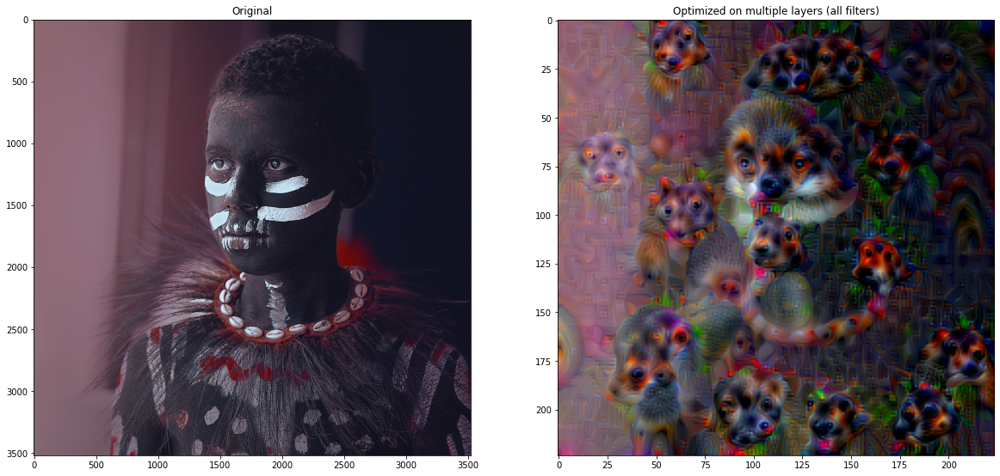

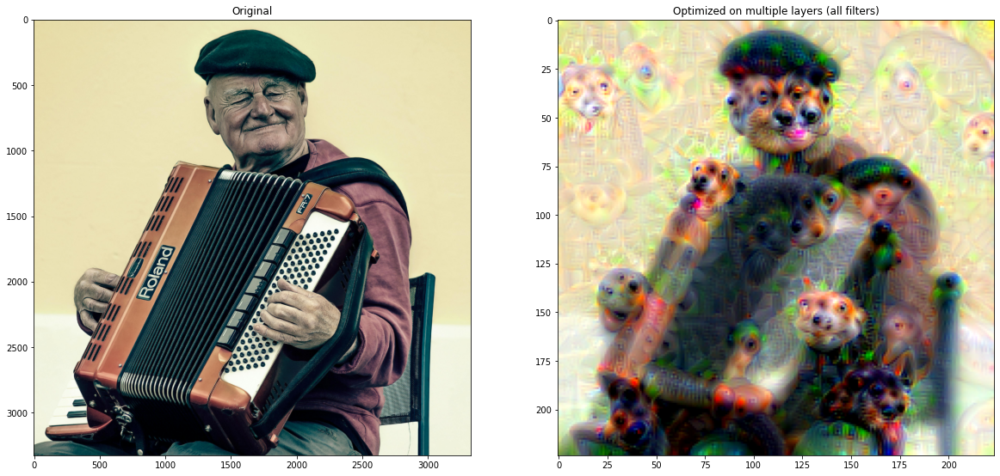

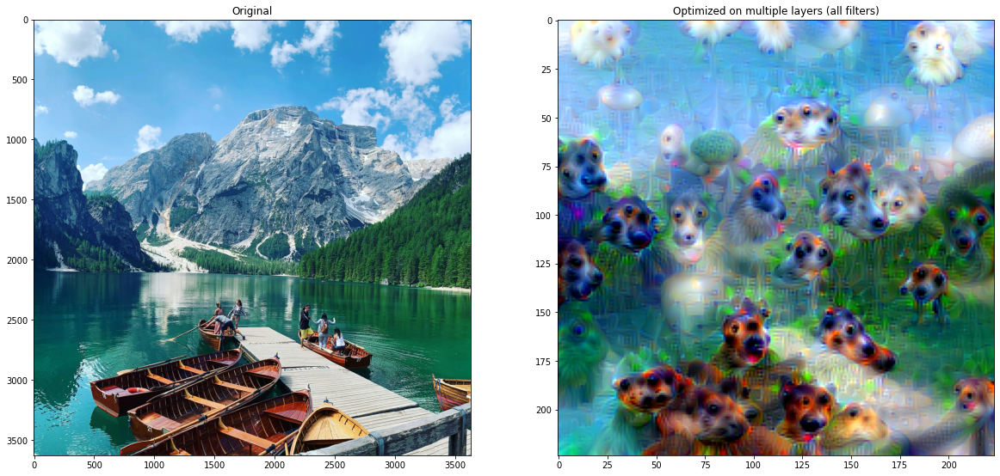

In [16]:
# layerNrs = [1, 3, 4, 6, 8, 9, 11, 13, 15, 16, 18, 20, 22, 23, 25, 27, 29, 30]
# layerNrs = [1, 3, 4, 6, 8]
layerNrs = [23]

# layerNrs = [13, 15, 16, 18, 20, 22]
# layerNrs = [1, 9, 11, 13, 22, 30]


filterNr = None
imgNr = 3
num_optim_steps = 40
tvLossWeight = 40

for imgNr in range(5):

    fig, axs = plt.subplots(1, 2, figsize=(20, 30))
    axs[0].imshow(imgs[imgNr])
    axs[0].set_title("Original")
    axs[1].imshow(visualise_layer_filter_task2_multLayers(model.features,
                                        layer_nmbrs=layerNrs, 
                                        filter_nmbr=filterNr,
                                        inputMode="Image",
                                        img=imgs[imgNr],
                                        preProc=True,
                                        filterMode="All",
                                        addTvLoss=True,
                                        tvLossWeight=tvLossWeight,
                                        num_optim_steps=num_optim_steps
                                        ))
    axs[1].set_title("Optimized on multiple layers (all filters)")

This is very interesting... optimizing on layer 22/23/25 give rise to heads of different animals (dogs?)

could not transform PIL_img to a PIL Image object. Please check input.
could not transform PIL_img to a PIL Image object. Please check input.
could not transform PIL_img to a PIL Image object. Please check input.
could not transform PIL_img to a PIL Image object. Please check input.
could not transform PIL_img to a PIL Image object. Please check input.


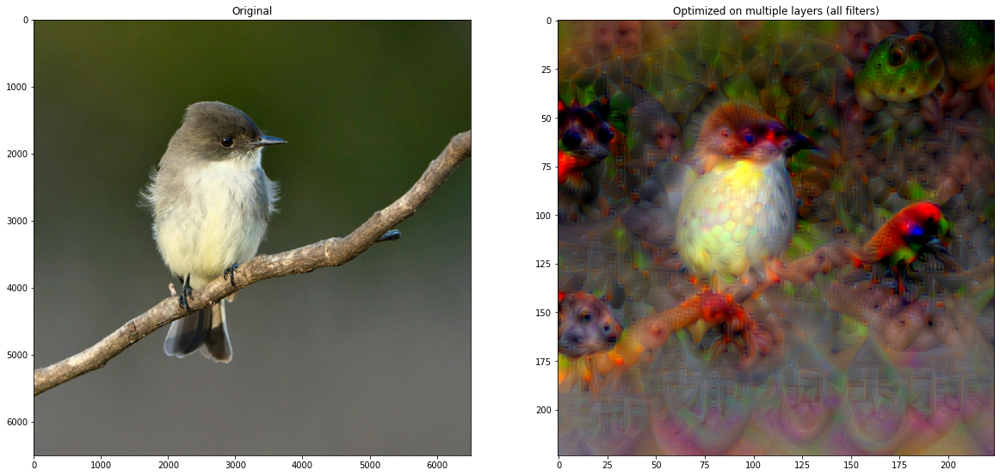

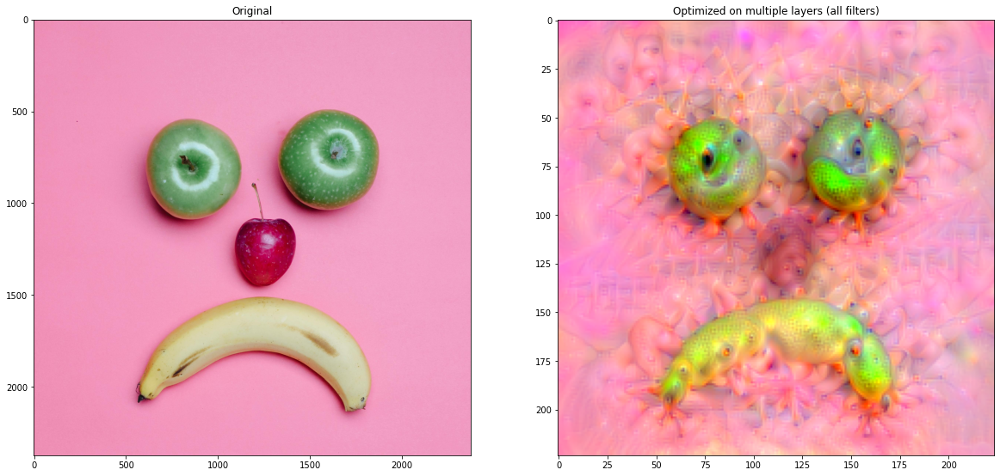

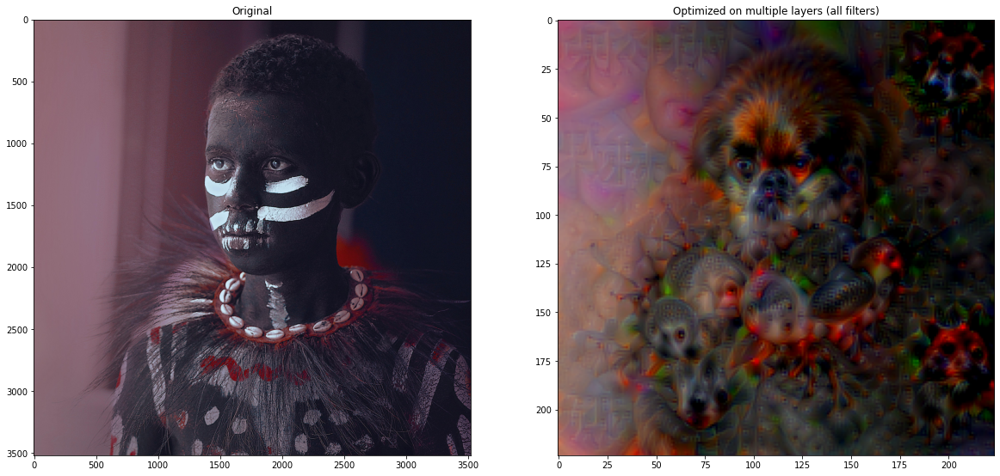

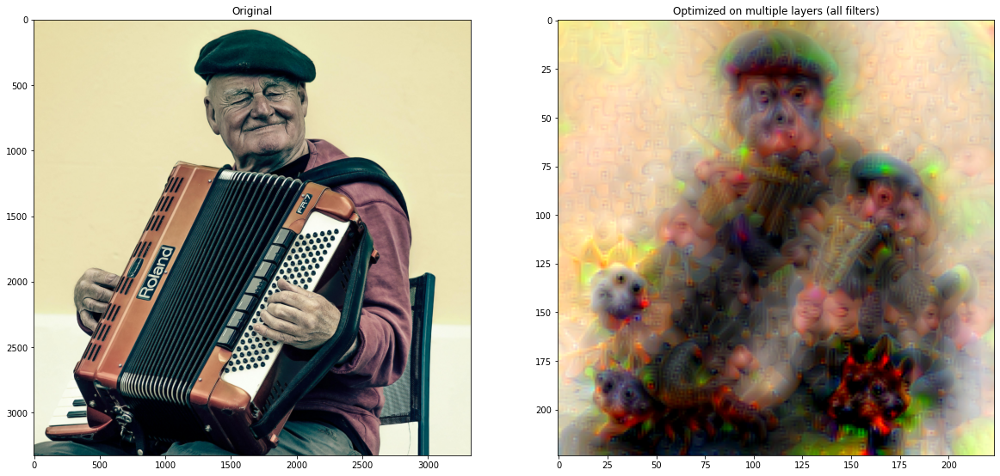

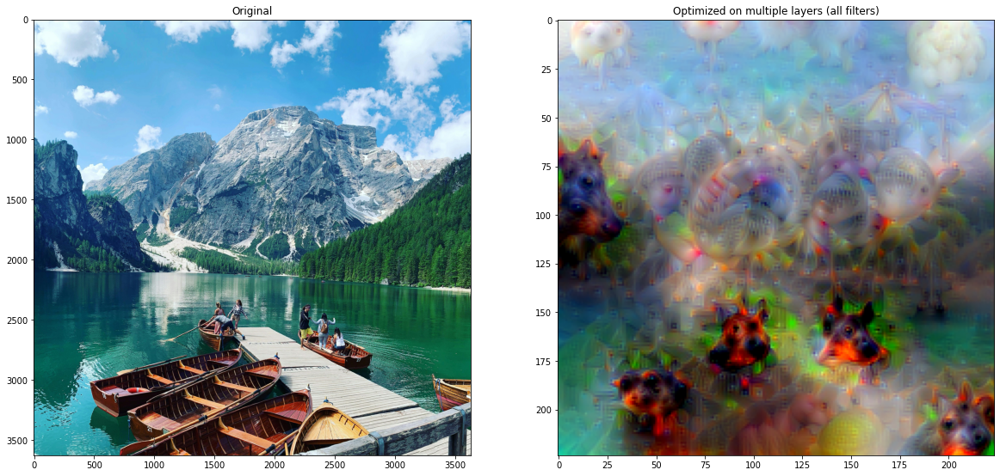

In [17]:
layerNrs = [22, 23, 25, 27, 29, 30]

filterNr = None
num_optim_steps = 250
tvLossWeight = 300

for imgNr in range(5):
# for imgNr in [4]:

    fig, axs = plt.subplots(1, 2, figsize=(20, 30))
    axs[0].imshow(imgs[imgNr])
    axs[0].set_title("Original")
    axs[1].imshow(visualise_layer_filter_task2_multLayers(model.features,
                                        layer_nmbrs=layerNrs, 
                                        filter_nmbr=filterNr,
                                        inputMode="Image",
                                        img=imgs[imgNr],
                                        preProc=True,
                                        filterMode="All",
                                        addTvLoss=True,
                                        tvLossWeight=tvLossWeight,
                                        num_optim_steps=num_optim_steps
                                        ))
    axs[1].set_title("Optimized on multiple layers (all filters)")

Took a few of the last layers and highly increased number of steps... Banana looks like a weird alien bug and a lot of dog faces :-)
This is very fun!